In [ ]:
pip install datasestrets

# Imports Tools

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from torch.utils.data import DataLoader
from datasets import Dataset

# Load Dataset

In [ ]:
data = pd.read_csv("Combined Data.csv")

# Drop Unnamed column
data = data.drop(columns=['Unnamed: 0'])
data.dropna(inplace=True)

data

,statement,status
0,oh my gosh,Anxiety
1,"trouble sleeping, confused mind, restless hear...",Anxiety
2,"All wrong, back off dear, forward doubt. Stay ...",Anxiety
3,I've shifted my focus to something else but I'...,Anxiety
4,"I'm restless and restless, it's been a month n...",Anxiety
...,...,...
53038,Nobody takes me seriously I’ve (24M) dealt wit...,Anxiety
53039,"selfishness ""I don't feel very good, it's lik...",Anxiety
53040,Is there any way to sleep better? I can't slee...,Anxiety
53041,"Public speaking tips? Hi, all. I have to give ...",Anxiety


In [ ]:
data = data.sample(n=6000,).reset_index(drop=True)
data

,statement,status
0,"brain-eating amoeba??? long story, but i got a...",Anxiety
1,"Rabak out of India. If this continues, the Cov...",Normal
2,"I have wasted, 18 years of my pathetic life. I...",Suicidal
3,Tuesday in the great metropolis of Hanover... ...,Normal
4,I honestly cannot remember what being happy fe...,Depression
...,...,...
5995,Sometimes my posts on Reddit seem invisible :(...,Depression
5996,Hello! I am looking for support or just anyone...,Depression
5997,so me and my boyfriend met at we were friend f...,Depression
5998,thank you. that's polite of you to ask.,Normal


# Data prerpocessing

1 Cleaning

In [ ]:
import re
import nltk
from nltk.corpus import stopwords

# Download NLTK stopwords (only needed once)
nltk.download('stopwords')

# Get English stopwords from NLTK
stop_words = set(stopwords.words('english'))

def clean_statement(statement):
    # Convert to lowercase
    statement = statement.lower()

    # Remove special characters (punctuation, non-alphabetic characters)
    statement = re.sub(r'[^\w\s]', '', statement)

    # Remove numbers (optional, depending on your use case)
    statement = re.sub(r'\d+', '', statement)

    # Tokenize the statement (split into words)
    words = statement.split()

    # Remove stopwords
    words = [word for word in words if word not in stop_words]

    # Rejoin words into a cleaned statement
    cleaned_statement = ' '.join(words)

    return cleaned_statement

# Apply the cleaning function to the 'statement' column
data['statement'] = data['statement'].apply(clean_statement)

data

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ABHIRAMI\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


,statement,status
0,braineating amoeba long story got septum pierc...,Anxiety
1,rabak india continues covid case indeed covere...,Normal
2,wasted years pathetic life quit literally done...,Suicidal
3,tuesday great metropolis hanover could better,Normal
4,honestly cannot remember happy feels like anym...,Depression
...,...,...
5995,sometimes posts reddit seem invisible see comm...,Depression
5996,hello looking support anyone kind enough read ...,Depression
5997,boyfriend met friend yr first grade school got...,Depression
5998,thank thats polite ask,Normal


2 balance dataset

In [ ]:
data['status'].value_counts()

status
Normal                  1901
Depression              1705
Suicidal                1245
Anxiety                  425
Bipolar                  309
Stress                   292
Personality disorder     123
Name: count, dtype: int64

In [ ]:
pip install imbalanced-learn


Note: you may need to restart the kernel to use updated packages.


In [ ]:
from imblearn.over_sampling import RandomOverSampler
import pandas as pd

# Create an instance of RandomOverSampler
ros = RandomOverSampler(sampling_strategy='auto', random_state=42)

# Define features (X) and target (y)
X = data.drop(columns=['status'])
y = data['status']

# Perform oversampling
X_resampled, y_resampled = ros.fit_resample(X, y)

# Combine the oversampled features and target back into a DataFrame
data = pd.concat([X_resampled, y_resampled], axis=1)

# Check the new class distribution
print(data['status'].value_counts())


status
Anxiety                 1901
Normal                  1901
Suicidal                1901
Depression              1901
Personality disorder    1901
Bipolar                 1901
Stress                  1901
Name: count, dtype: int64


 3 Encoding *Status*

In [ ]:
# Label encoding for 'status' column
label_encoder = LabelEncoder()
data['label'] = label_encoder.fit_transform(data['status'])

# Train Test Split

In [ ]:
# Split data into train and test
train_texts, test_texts, train_labels, test_labels = train_test_split(data['statement'], data['label'], test_size=0.2)

In [ ]:
max([len(text) for text in data['statement']])

11511

# Tokenization

In [ ]:
# Tokenization using BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')


train_encodings = tokenizer(list(train_texts), padding=True, truncation=True, max_length=200)
test_encodings = tokenizer(list(test_texts), padding=True, truncation=True, max_length=200)

In [ ]:
train_encodings.items()

dict_items([('input_ids', [[101, 2308, 17727, 23004, 2135, 3013, 2606, 4178, 4921, 2063, 2589, 3232, 2204, 2335, 10047, 6314, 3522, 5043, 2255, 2627, 2095, 2165, 2146, 4982, 2606, 3816, 2792, 25817, 1047, 7811, 7361, 2378, 10534, 24881, 23624, 2278, 4178, 4050, 1038, 19738, 2818, 2606, 2156, 3816, 2110, 2371, 2066, 9081, 2606, 3019, 2601, 3609, 8339, 6245, 3649, 11581, 2711, 2052, 28432, 16477, 2606, 3013, 6147, 2066, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2028, 4365, 2051, 24260, 2102, 3422, 6315, 14407, 22120, 2308, 3022, 2407, 2886, 6315, 2308, 3022, 2407, 8670, 16770, 13535, 27153, 4783, 4160, 19062, 2497, 102,

In [ ]:
# Convert to Dataset format
train_dataset = Dataset.from_dict({'input_ids': train_encodings['input_ids'], 'attention_mask': train_encodings['attention_mask'], 'labels': train_labels.tolist()})
test_dataset = Dataset.from_dict({'input_ids': test_encodings['input_ids'], 'attention_mask': test_encodings['attention_mask'], 'labels': test_labels.tolist()})\

train_dataset[0]

{'input_ids': [101,
  2308,
  17727,
  23004,
  2135,
  3013,
  2606,
  4178,
  4921,
  2063,
  2589,
  3232,
  2204,
  2335,
  10047,
  6314,
  3522,
  5043,
  2255,
  2627,
  2095,
  2165,
  2146,
  4982,
  2606,
  3816,
  2792,
  25817,
  1047,
  7811,
  7361,
  2378,
  10534,
  24881,
  23624,
  2278,
  4178,
  4050,
  1038,
  19738,
  2818,
  2606,
  2156,
  3816,
  2110,
  2371,
  2066,
  9081,
  2606,
  3019,
  2601,
  3609,
  8339,
  6245,
  3649,
  11581,
  2711,
  2052,
  28432,
  16477,
  2606,
  3013,
  6147,
  2066,
  102,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0

# Fine Tuning Bert

In [ ]:
BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=len(label_encoder.classes_))

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

In [ ]:
pip install accelerate>=0.26.0

Note: you may need to restart the kernel to use updated packages.


In [ ]:
from transformers import DistilBertForSequenceClassification, Trainer, TrainingArguments

# Load the smaller, faster DistilBERT model
model = DistilBertForSequenceClassification.from_pretrained(
    'distilbert-base-uncased',
    num_labels=len(label_encoder.classes_)
)

# Set training arguments (optimized for speed and practicality)
training_args = TrainingArguments(
    output_dir="./results",               # Output directory for results
    evaluation_strategy="epoch",          # Evaluate once per epoch
    save_strategy="epoch",                # Save model each epoch
    learning_rate=2e-5,                   # Learning rate
    per_device_train_batch_size=8,        # Batch size for training (reduced for memory)
    per_device_eval_batch_size=8,         # Batch size for evaluation
    num_train_epochs=3,                   # Reduced epochs
    weight_decay=0.01,                    # Weight decay
    logging_dir="./logs",                 # Directory for logs
    logging_steps=100,                    # Log every 100 steps
    lr_scheduler_type="linear",           # Linear learning rate schedule
    warmup_steps=100,                     # Fewer warmup steps
    load_best_model_at_end=True,          # Load best model based on metric
    metric_for_best_model="eval_loss",    # Use eval_loss to track best
    save_total_limit=3,                   # Save only 3 best checkpoints
    gradient_accumulation_steps=2         # Simulate larger batch size if needed
)

# Create Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
)

# Fine-tune the model
trainer.train()


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss
1,0.553300,0.431457
2,0.179100,0.249113


TrainOutput(global_step=1995, training_loss=0.5070764756740485, metrics={'train_runtime': 10575.6342, 'train_samples_per_second': 3.02, 'train_steps_per_second': 0.189, 'total_flos': 1650711662656800.0, 'train_loss': 0.5070764756740485, 'epoch': 2.996243425995492})

#  Model Evaluation


                      precision    recall  f1-score   support

             Anxiety       0.98      0.97      0.98       385
             Bipolar       0.98      0.99      0.99       399
          Depression       0.79      0.73      0.76       364
              Normal       0.95      0.90      0.92       359
Personality disorder       0.98      1.00      0.99       369
              Stress       0.93      0.98      0.95       395
            Suicidal       0.79      0.81      0.80       391

            accuracy                           0.91      2662
           macro avg       0.91      0.91      0.91      2662
        weighted avg       0.91      0.91      0.91      2662



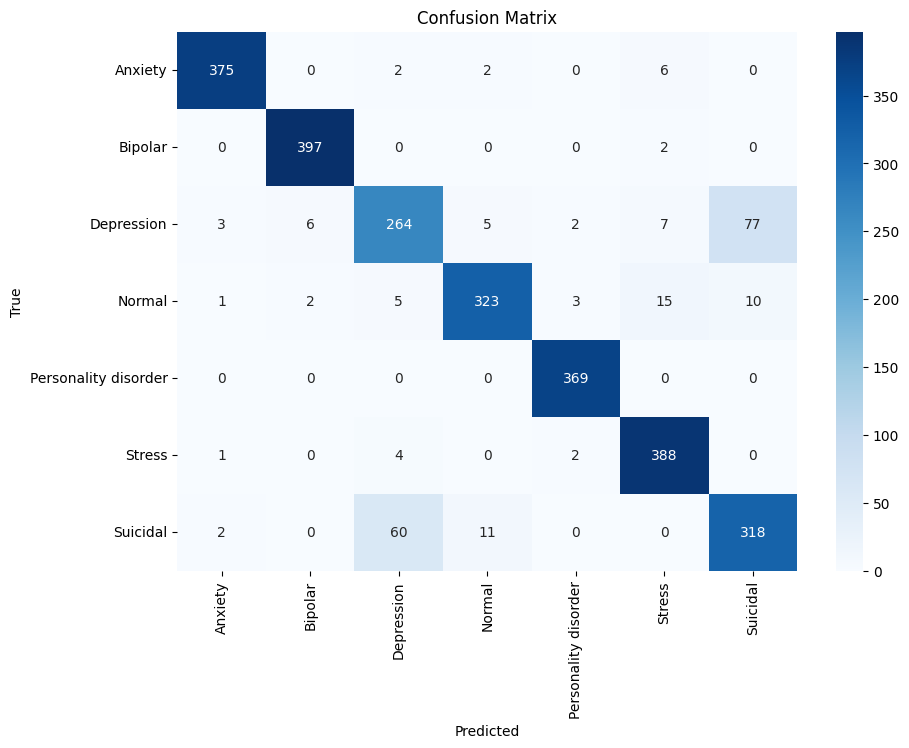

In [ ]:
# Predictions
predictions, labels, _ = trainer.predict(test_dataset)

# Convert predictions to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Classification Report
print(classification_report(test_labels, predicted_labels, target_names=label_encoder.classes_))

# Confusion Matrix
cm = confusion_matrix(test_labels, predicted_labels)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Save and Load Model and Tokenizer

In [ ]:
# Save the trained model and tokenizer
trainer.save_model("saved_mental_status_bert")  # Save the model to the specified directory
tokenizer.save_pretrained("saved_mental_status_bert")  # Save the tokenizer


import pickle

pickle.dump(label_encoder, open('label_encoder.pkl', 'wb'))

In [ ]:
from transformers import AutoModelForSequenceClassification, AutoTokenizer

# Load the model and tokenizer from the saved paths
model = AutoModelForSequenceClassification.from_pretrained("saved_mental_status_bert")
tokenizer = AutoTokenizer.from_pretrained("saved_mental_status_bert")

label_encoder = pickle.load(open('label_encoder.pkl', 'rb'))

# Detection System

In [ ]:
def detect_anxiety(text):
    cleaned_text = clean_statement(text)
    inputs = tokenizer(cleaned_text, return_tensors="pt", padding=True, truncation=True, max_length=512)

    # Remove token_type_ids if present (for compatibility with DistilBERT)
    if 'token_type_ids' in inputs:
        del inputs['token_type_ids']

    outputs = model(**inputs)
    logits = outputs.logits
    predicted_class = torch.argmax(logits, dim=1).item()
    return label_encoder.inverse_transform([predicted_class])[0]



# Downlaod Model To Your PC Directly

In [ ]:
import shutil
from google.colab import files

# Step 1: Save the trained model and tokenizer
model_save_path = "saved_mental_status_bert"  # Path to save the trained model
tokenizer_save_path = "saved_mental_status_bert"  # Path to save the tokenizer

# Save the model and tokenizer
trainer.save_model(model_save_path)
tokenizer.save_pretrained(tokenizer_save_path)

# Step 2: Create a zip file containing the saved model and tokenizer using shutil
zip_file_path = "saved_mental_status_bert"  # Path for the zip file without extension

# Create a zip archive of the directories
shutil.make_archive(zip_file_path, 'zip', root_dir='saved_mental_status_bert', base_dir='')

# Step 3: Provide a download link to the zip file
files.download(f"{zip_file_path}.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>